In [12]:
import os 
import shutil 
import glob 
from tqdm import tqdm
from PIL import Image, ImageDraw
import torch
import numpy as np

In [13]:
# Корневая папка проекта 
path_to_files = "b:/VIZIT/yolov5"

In [14]:
# Путь к папке с изображениями
input_image_path = path_to_files + "/input_photo"

In [15]:
# Функция для изменения размеров изображения и переноса изображения и labels в папку resized
def scale_image(input_image_path,
                      path_to_files=path_to_files
                      ):
    """
        Функция приводит изображение к размеру 640х640, 
        производит поворот изображения в соответствии с exif данными.
            Args:
                input_image_path (string): путь к изображению
                path_to_files (string): путь к корневой папке проекта
                                    
            Returns:
                None (None)    
    """
    
    path_to_resized_images = ''.join((path_to_files, '/resized_images/'))
    
    original_image = Image.open(input_image_path)
    resized_image = original_image.resize((640, 640), Image.LANCZOS)
    
    if hasattr(original_image, '_getexif') or original_image._getexif() is not None:
        orientation = original_image._getexif().get(0x112)
        rotate_values = {3: 180, 6: 270, 8: 90}
        if orientation in rotate_values:
            img = resized_image.rotate(rotate_values[orientation])
        else:
            img = resized_image    
        
    resized_image_path = ''.join((path_to_resized_images, input_image_path.split('\\')[-1]))
    img.save(resized_image_path)


In [16]:
# Преобразованные файлы изображений

path_to_resized_images = ''.join((path_to_files, '/resized_images/'))
# Очистка папки resized_images
if os.path.exists(path_to_resized_images):
    shutil.rmtree(path_to_resized_images)
os.mkdir(path_to_resized_images)
# Заполнение папки resized_images    
img_names_list = glob.glob(input_image_path +'/*.jpg')    
for img_name in tqdm(img_names_list):
    scale_image(img_name)

100%|██████████| 26/26 [00:04<00:00,  6.21it/s]


In [17]:
# Модель для класса 0
model_0 = torch.hub.load('./', 'custom', path='./m_cl_0.pt', 
            source='local', device='cpu', force_reload=True, _verbose=False)

YOLOv5  v7.0-21-ga1b6e79 Python-3.9.12 torch-1.8.1+cpu CPU

Fusing layers... 
YOLOv5m summary: 212 layers, 20852934 parameters, 0 gradients, 47.9 GFLOPs
Adding AutoShape... 


In [18]:
# Модель для классов 1 и 2
model_1 = torch.hub.load('./', 'custom', path='./m_cl_1_2.pt', 
            source='local', device='cpu', force_reload=True, _verbose=False)

YOLOv5  v7.0-21-ga1b6e79 Python-3.9.12 torch-1.8.1+cpu CPU

Fusing layers... 
YOLOv5m summary: 212 layers, 20856975 parameters, 0 gradients, 47.9 GFLOPs
Adding AutoShape... 


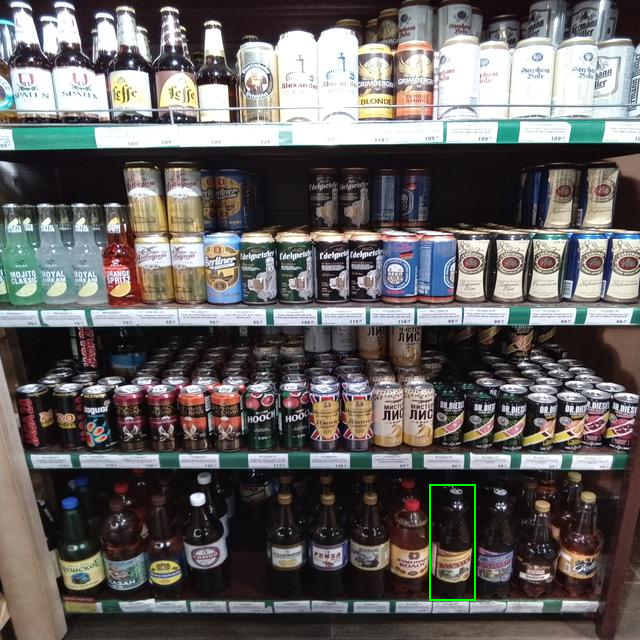

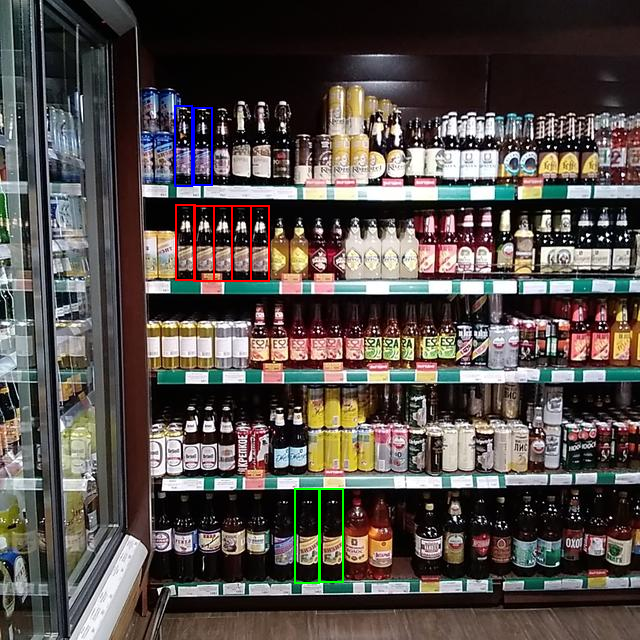

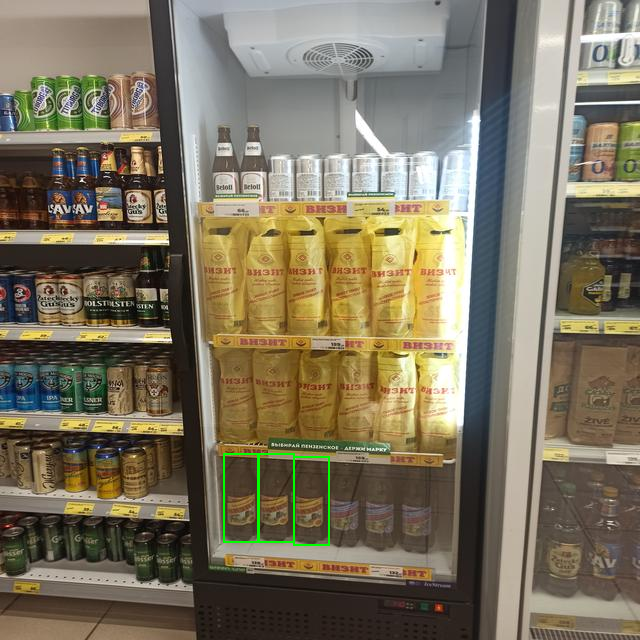

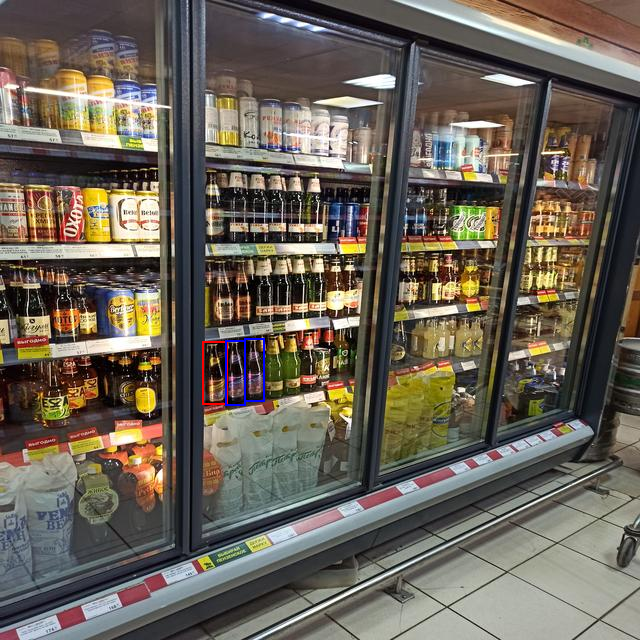

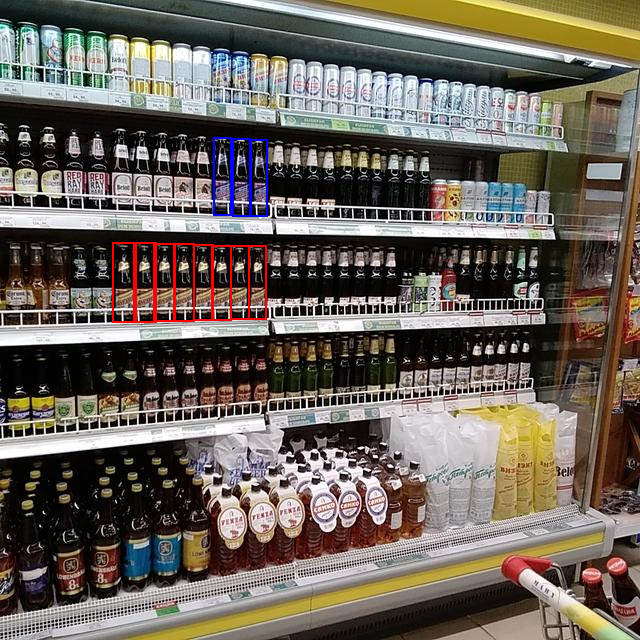

...

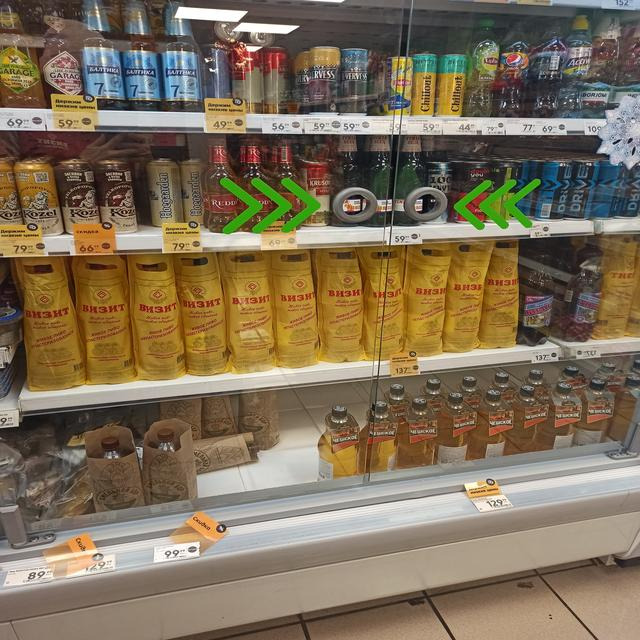

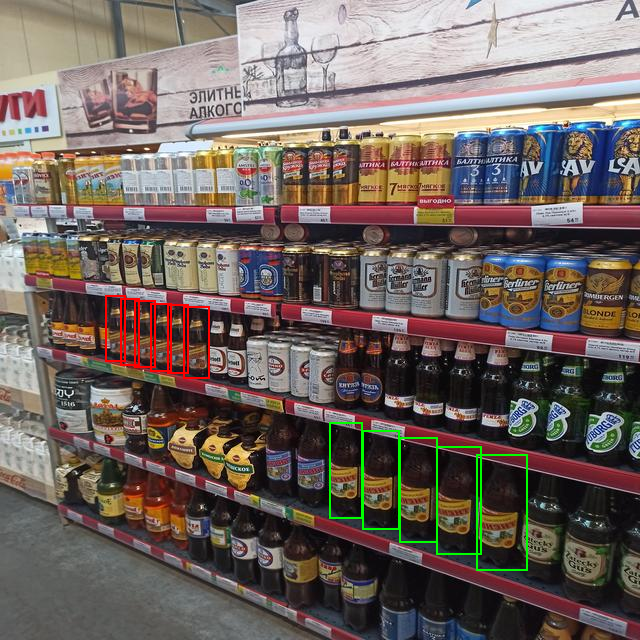

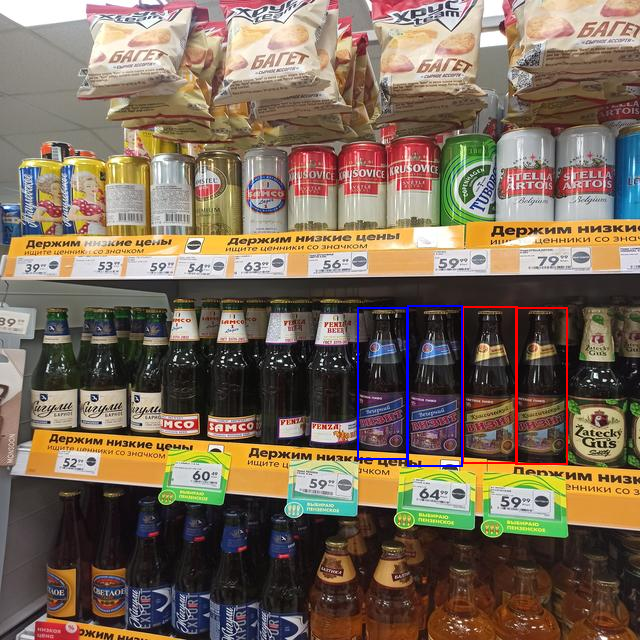

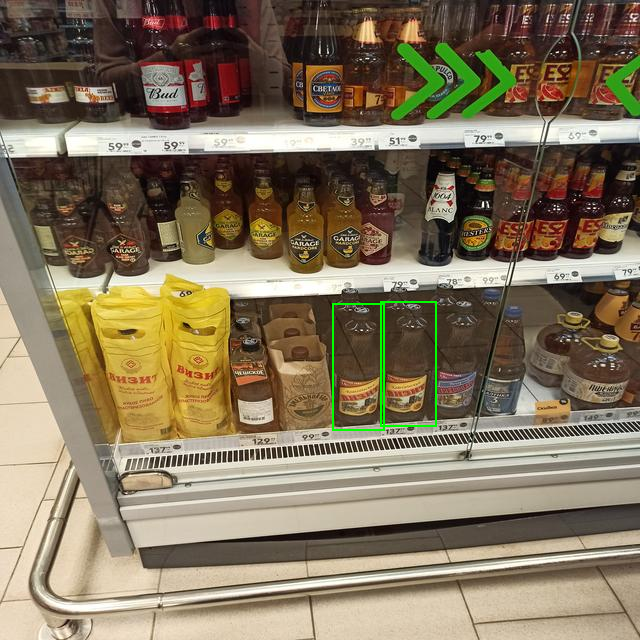

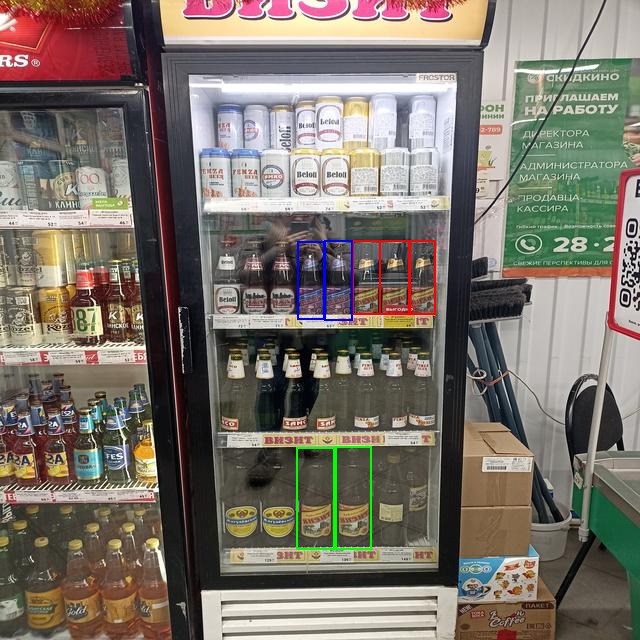

In [19]:
color_dict = {0:(0,255,0), 1:(0,0,255)}


# Для всех преобразованныйх изображений:
for imageName in glob.glob(path_to_resized_images+'*.jpg'):
    # Открываем изображение   
    img = Image.open(imageName)
    # Делаем предикт
    result_0 = model_0(img, size=640)
    result_1 = model_1(img, size=640)
    draw = ImageDraw.Draw(img)
    # Если есть детектированные объекты класса 0
    if len(result_0.xyxy[0]) != 0:
        # Наносим рамки на изображение
        for i in range(len(result_0.xyxy[0])):
            draw.rectangle(tuple(result_0.xyxy[0][i][:4].tolist()), outline=(255, 0, 0), width=2 )
    # Если есть детектированные объекты классов 1 и 2
    if len(result_1.xyxy[0]) != 0:
        # Наносим рамки на изображение
        for i in range(len(result_1.xyxy[0])):
            curr_cl = int(result_1.xyxy[0][i].tolist()[-1])
            curr_lbl = tuple(result_1.xyxy[0][i].tolist()[:4])
            draw.rectangle(curr_lbl, outline=color_dict[curr_cl], width=2 )
    # Вывод на экран       
    display(img)